<br></br>
# **나이브베이즈 한글 적용**
네이버 영화리뷰 데이터 활용
1. 0 : 부정적인 리뷰
1. 1 : 긍정적인 리뷰

<br></br>
## **1 NAVER 영화리뷰 데이터 전처리**
1. https://github.com/e9t/nsmc
1. https://www.nltk.org/book/ch06.html

In [1]:
! cat ./data/ratings_test.txt | head -n 10

id	document	label
6270596	굳 ㅋ	1
9274899	GDNTOPCLASSINTHECLUB	0
8544678	뭐야 이 평점들은.... 나쁘진 않지만 10점 짜리는 더더욱 아니잖아	0
6825595	지루하지는 않은데 완전 막장임... 돈주고 보기에는....	0
6723715	3D만 아니었어도 별 다섯 개 줬을텐데.. 왜 3D로 나와서 제 심기를 불편하게 하죠??	0
7898805	음악이 주가 된, 최고의 음악영화	1
6315043	진정한 쓰레기	0
6097171	마치 미국애니에서 튀어나온듯한 창의력없는 로봇디자인부터가,고개를 젖게한다	0
8932678	갈수록 개판되가는 중국영화 유치하고 내용없음 폼잡다 끝남 말도안되는 무기에 유치한cg남무 아 그립다 동사서독같은 영화가 이건 3류아류작이다	0
cat: 쓰기 오류: 파이프가 깨어짐


In [2]:
def read_data(filename):
    with open(filename, 'r', encoding='utf-8') as f:
        data = [line.split('\t') for line in f.read().splitlines()]
        data = data[1:]   # header 제외
        
    from random import randint
    random_data = [data[randint(1, len(data))]  for no in range(int(len(data)/50)) ]
    return random_data

train_data = read_data('./data/ratings_train.txt')
test_data  = read_data('./data/ratings_test.txt')
print('Train_data : {}\nsample     : {}'.format(len(train_data), train_data[:3]))
print('Test_data  : {}\nsample     : {}'.format(len(test_data),  test_data[:3]))

Train_data : 3000
sample     : [['10004592', '추억이자 명작이라고할수있네요', '1'], ['8564495', '다시봐도 대작이다~~ 밀라', '1'], ['3489723', '소재 선택은 좋았는데 연기도 꽝이고 전개 과정도 이상하고 볼거리도 없다', '0']]
Test_data  : 1000
sample     : [['2299937', '이런게 진정한 쓰레기 별 반개도 아깝다', '0'], ['7501441', '재미짱', '1'], ['647345', '너무 똑똑해 돌아이가 될 수 없었던 돌아이 4, 최재성', '0']]


In [3]:
%%time
from konlpy.tag import Okt
pos_tagger = Okt()

def tokenize(doc):
    result = ['/'.join(t) for t in pos_tagger.pos(doc, norm=True, stem=True)]
    return result 

train_docs = [(tokenize(row[1]), row[2])    for row in train_data]
test_docs  = [(tokenize(row[1]), row[2])    for row in test_data]

from pprint import pprint
pprint(train_docs[:2])

[(['추억/Noun', '이자/Noun', '명작/Noun', '이라고/Josa', '하다/Verb'], '1'),
 (['다시/Noun',
   '보다/Verb',
   '대작/Noun',
   '이다/Josa',
   '~~/Punctuation',
   '밀/Noun',
   '라/Josa'],
  '1')]
CPU times: user 25.2 s, sys: 423 ms, total: 25.7 s
Wall time: 14 s


In [4]:
tokens = [t   for d in train_docs 
              for t in d[0]]
print("Token Total :{}\nSample : {}".format(
    len(tokens), tokens[:5]))

Token Total :43089
Sample : ['추억/Noun', '이자/Noun', '명작/Noun', '이라고/Josa', '하다/Verb']


<br></br>
## **2 nltk 를 활용하여 연산모델 만들기**
https://github.com/e9t/nsmc

In [5]:
import nltk
text = nltk.Text(tokens, name='NMSC')

print("number of Token : {} \nunique Token    : {}\n".format(
    len(text.tokens), len(set(text.tokens))))
pprint(text.vocab().most_common(5))    

number of Token : 43089 
unique Token    : 6845

[('./Punctuation', 1331),
 ('영화/Noun', 1020),
 ('하다/Verb', 861),
 ('보다/Verb', 791),
 ('이/Josa', 761)]


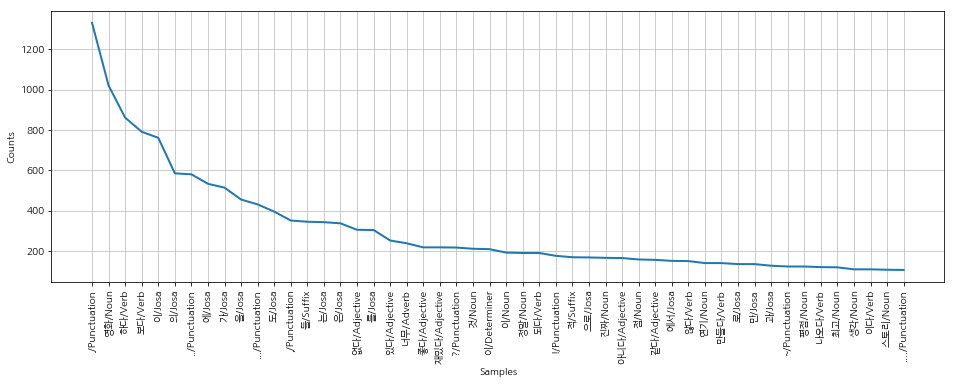

In [6]:
%matplotlib inline
from matplotlib import rc
rc('font', family='NanumGothic')

import matplotlib.pyplot as plt
plt.figure(figsize=(16,5))
text.plot(50) 

<br></br>
## **3 모델의 정확도/ 일반화를 높이는 추가작업**
우도 상위 4000개 데이터를 추출

In [7]:
selected_words = [f[0] for f in text.vocab().most_common(4000)]
selected_words[:5]

['./Punctuation', '영화/Noun', '하다/Verb', '보다/Verb', '이/Josa']

In [21]:
%%time
def term_exists(doc):
    return {'exists({})'.format(word): (word in set(doc)) for word in selected_words}

train_docs = train_docs[:10000]
train_xy   = [(term_exists(d), c) for d, c in train_docs]
test_xy    = [(term_exists(d), c) for d, c in test_docs]

CPU times: user 14 s, sys: 677 ms, total: 14.7 s
Wall time: 14.7 s


In [22]:
train_xy[:10]

[({'exists(./Punctuation)': False,
   'exists(영화/Noun)': False,
   'exists(하다/Verb)': True,
   'exists(보다/Verb)': False,
   'exists(이/Josa)': False,
   'exists(의/Josa)': False,
   'exists(../Punctuation)': False,
   'exists(에/Josa)': False,
   'exists(가/Josa)': False,
   'exists(을/Josa)': False,
   'exists(.../Punctuation)': False,
   'exists(도/Josa)': False,
   'exists(,/Punctuation)': False,
   'exists(들/Suffix)': False,
   'exists(는/Josa)': False,
   'exists(은/Josa)': False,
   'exists(없다/Adjective)': False,
   'exists(를/Josa)': False,
   'exists(있다/Adjective)': False,
   'exists(너무/Adverb)': False,
   'exists(좋다/Adjective)': False,
   'exists(재밌다/Adjective)': False,
   'exists(?/Punctuation)': False,
   'exists(것/Noun)': False,
   'exists(이/Determiner)': False,
   'exists(이/Noun)': False,
   'exists(정말/Noun)': False,
   'exists(되다/Verb)': False,
   'exists(!/Punctuation)': False,
   'exists(적/Suffix)': False,
   'exists(으로/Josa)': False,
   'exists(진짜/Noun)': False,
   'exists(아니다/

In [9]:
%%time
classifiers = nltk.NaiveBayesClassifier.train(train_xy)

CPU times: user 14.6 s, sys: 11.8 ms, total: 14.6 s
Wall time: 14.6 s


<br></br>
## **4 생성한 모델을 평가**
Accuracy
1. 0 : 부정리뷰
1. 1 : 긍정리뷰

In [10]:
classifiers.labels()

['1', '0']

In [23]:
classifiers.show_most_informative_features(25)

Most Informative Features
        exists(쓰레기/Noun) = True                0 : 1      =     18.5 : 1.0
   exists(아깝다/Adjective) = True                0 : 1      =     15.5 : 1.0
         exists(최악/Noun) = True                0 : 1      =     15.3 : 1.0
        exists(차라리/Noun) = True                0 : 1      =     14.4 : 1.0
          exists(굿/Noun) = True                1 : 0      =     14.3 : 1.0
  exists(^^/Punctuation) = True                1 : 0      =     14.1 : 1.0
         exists(찍다/Verb) = True                0 : 1      =     12.4 : 1.0
  exists(필요없다/Adjective) = True                1 : 0      =     12.3 : 1.0
  exists(재미없다/Adjective) = True                0 : 1      =     12.1 : 1.0
         exists(최고/Noun) = True                1 : 0      =     10.7 : 1.0
         exists(재다/Verb) = True                1 : 0      =     10.2 : 1.0
  exists(어설프다/Adjective) = True                0 : 1      =      9.7 : 1.0
          exists(머/Noun) = True                0 : 1      =      9.7 : 1.0

In [12]:
%%time
'네이버 긍부정 모델의 Accuracy : {}'.format(
    nltk.classify.accuracy(classifiers, test_xy))

CPU times: user 9.99 s, sys: 7.93 ms, total: 10 s
Wall time: 9.99 s


'네이버 긍부정 모델의 Accuracy : 0.767'

<br></br>
## **5 모델의 활용**
1. 0 : 부정리뷰
1. 1 : 긍정리뷰

In [17]:
review = """이영화 보다가 웃고만 나왔네요 최고에요"""

In [18]:
review = tokenize(review)    # 문법 Tag 추가한 객체로 변환
review

['이영화/Noun', '보다/Verb', '웃다/Verb', '나오다/Verb', '최고/Noun', '에요/Josa']

In [19]:
review = term_exists(review) # 기준 용어들이 포함여부 판단
for k, v in review.items():
    if v == True:
        print("{} = {}".format(k, v))

exists(보다/Verb) = True
exists(나오다/Verb) = True
exists(최고/Noun) = True
exists(이영화/Noun) = True
exists(에요/Josa) = True
exists(웃다/Verb) = True


In [20]:
classifiers.classify(review)  # 분류모델 평가

'1'